In [1]:
import datetime as dt
import warnings
from datetime import timedelta
from pathlib import Path
import folium
import geopandas as gpd
import lightgbm as lgb
import matplotlib.dates as mdates
import matplotlib.pyplot as plt
import missingno as msno
import numpy as np
import pandas as pd
import seaborn as sns
from branca.colormap import linear
from folium import plugins
from folium.features import DivIcon, GeoJson, GeoJsonTooltip
from folium.plugins import HeatMap, MarkerCluster
from IPython.display import display
from matplotlib.ticker import FuncFormatter
from shapely import wkt
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.model_selection import KFold, cross_val_score, train_test_split
from sklearn.preprocessing import StandardScaler

warnings.filterwarnings("ignore")
pd.set_option("display.max_columns", None)

In [2]:
base = Path("../data/raw")
months = [f"{m:02d}" for m in range(1, 7)]
files = [base / f"yellow_tripdata_2025-{m}.parquet" for m in months]
data = pd.concat((pd.read_parquet(fp) for fp in files), ignore_index=True)

In [3]:
df = data.copy()

## Dataset Overview

In [4]:
df.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee
0,1,2025-01-01 00:18:38,2025-01-01 00:26:59,1.0,1.60,1.0,N,229,237,1,10.0,3.5,0.5,3.00,0.0,1.0,18.00,2.5,0.0,0.0
1,1,2025-01-01 00:32:40,2025-01-01 00:35:13,1.0,0.50,1.0,N,236,237,1,5.1,3.5,0.5,2.02,0.0,1.0,12.12,2.5,0.0,0.0
2,1,2025-01-01 00:44:04,2025-01-01 00:46:01,1.0,0.60,1.0,N,141,141,1,5.1,3.5,0.5,2.00,0.0,1.0,12.10,2.5,0.0,0.0
3,2,2025-01-01 00:14:27,2025-01-01 00:20:01,3.0,0.52,1.0,N,244,244,2,7.2,1.0,0.5,0.00,0.0,1.0,9.70,0.0,0.0,0.0
4,2,2025-01-01 00:21:34,2025-01-01 00:25:06,3.0,0.66,1.0,N,244,116,2,5.8,1.0,0.5,0.00,0.0,1.0,8.30,0.0,0.0,0.0


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24083384 entries, 0 to 24083383
Data columns (total 20 columns):
 #   Column                 Dtype         
---  ------                 -----         
 0   VendorID               int32         
 1   tpep_pickup_datetime   datetime64[us]
 2   tpep_dropoff_datetime  datetime64[us]
 3   passenger_count        float64       
 4   trip_distance          float64       
 5   RatecodeID             float64       
 6   store_and_fwd_flag     object        
 7   PULocationID           int32         
 8   DOLocationID           int32         
 9   payment_type           int64         
 10  fare_amount            float64       
 11  extra                  float64       
 12  mta_tax                float64       
 13  tip_amount             float64       
 14  tolls_amount           float64       
 15  improvement_surcharge  float64       
 16  total_amount           float64       
 17  congestion_surcharge   float64       
 18  Airport_fee         

In [6]:
describe = df.describe(include="number")
display(describe.style.format("{:,.2f}"))

,VendorID,passenger_count,trip_distance,RatecodeID,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee
count,"24,083,384.00","18,664,783.00","24,083,384.00","18,664,783.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","24,083,384.00","18,664,783.00","18,664,783.00","24,083,384.00"
mean,1.84,1.29,6.83,2.48,162.22,161.78,0.95,17.89,1.22,0.48,2.86,0.48,0.96,26.36,2.21,0.14,0.53
std,0.61,0.74,630.57,11.57,65.98,70.21,0.74,191.09,1.85,0.14,3.89,2.07,0.28,191.56,0.93,0.51,0.36
min,1.00,0.00,0.00,1.00,1.00,1.00,0.00,"-1,807.60",-17.39,-21.74,-220.00,-148.17,-1.00,"-1,832.85",-2.50,-1.75,-0.75
25%,2.00,1.00,1.02,1.00,116.00,112.00,1.00,8.60,0.00,0.50,0.00,0.00,1.00,15.60,2.50,0.00,0.00
50%,2.00,1.00,1.80,1.00,161.00,162.00,1.00,13.50,0.00,0.50,2.14,0.00,1.00,20.93,2.50,0.00,0.75
75%,2.00,1.00,3.49,1.00,233.00,234.00,1.00,21.84,2.50,0.50,3.93,0.00,1.00,29.68,2.50,0.00,0.75
max,7.00,9.00,"386,088.43",99.00,265.00,265.00,5.00,"863,372.12",133.60,22.14,960.94,916.87,1.00,"863,380.37",2.50,6.75,1.50


In [7]:
df.duplicated().sum()

np.int64(0)

In [8]:
df.groupby(df["tpep_pickup_datetime"].dt.to_period("Y")).size()

tpep_pickup_datetime
2007           1
2009           2
2024          21
2025    24083360
Freq: Y-DEC, dtype: int64

In [9]:
df = df[df["tpep_pickup_datetime"].dt.to_period("Y") == "2025"]

## Missing Values

In [10]:
df.isnull().sum()

VendorID                       0
tpep_pickup_datetime           0
tpep_dropoff_datetime          0
passenger_count          5418601
trip_distance                  0
RatecodeID               5418601
store_and_fwd_flag       5418601
PULocationID                   0
DOLocationID                   0
payment_type                   0
fare_amount                    0
extra                          0
mta_tax                        0
tip_amount                     0
tolls_amount                   0
improvement_surcharge          0
total_amount                   0
congestion_surcharge     5418601
Airport_fee              5418601
cbd_congestion_fee             0
dtype: int64

In [11]:
100 * df.isna().mean().sort_values(ascending=False)

passenger_count          22.499356
congestion_surcharge     22.499356
store_and_fwd_flag       22.499356
RatecodeID               22.499356
Airport_fee              22.499356
tpep_dropoff_datetime     0.000000
VendorID                  0.000000
tpep_pickup_datetime      0.000000
DOLocationID              0.000000
payment_type              0.000000
trip_distance             0.000000
PULocationID              0.000000
extra                     0.000000
fare_amount               0.000000
mta_tax                   0.000000
tip_amount                0.000000
improvement_surcharge     0.000000
tolls_amount              0.000000
total_amount              0.000000
cbd_congestion_fee        0.000000
dtype: float64

<Axes: >

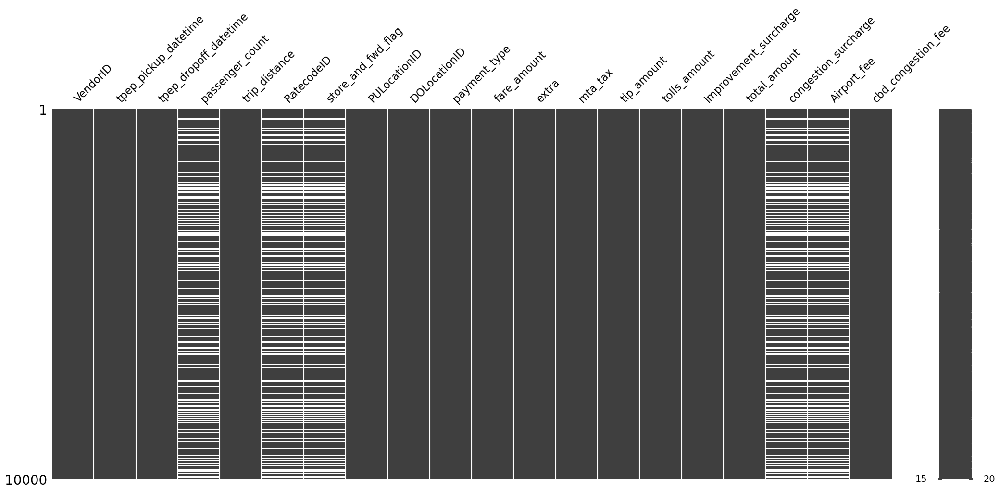

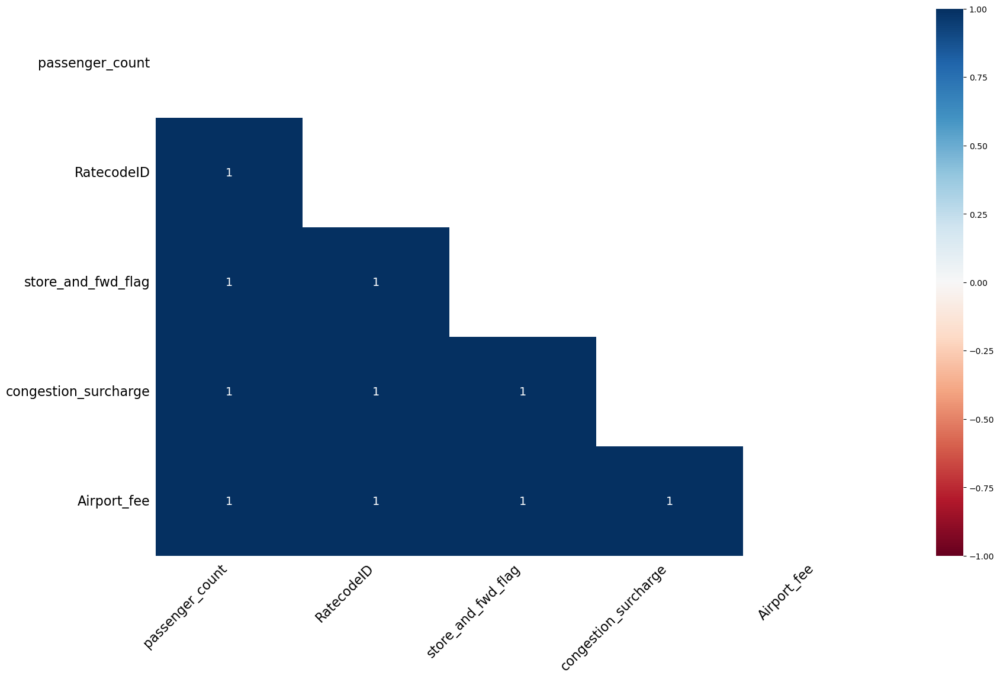

In [12]:
msno.matrix(df.sample(10000))
msno.heatmap(df)

In [13]:
df.groupby("VendorID")["passenger_count"].apply(lambda g: g.isna().mean() * 100)

VendorID
1     16.046088
2     24.361130
6    100.000000
7      0.000000
Name: passenger_count, dtype: float64

In [14]:
missing_rows = df[df.isna().any(axis=1)]
missing_rows.groupby(missing_rows["tpep_pickup_datetime"].dt.month).size()

tpep_pickup_datetime
1     540149
2     806937
3     916663
4     745730
5    1196176
6    1212946
dtype: int64

In [15]:
na_subset = df[df["passenger_count"].isna()]
non_na_subset = df[df["passenger_count"].notna()]

print("Average fare (NA subset):", na_subset["fare_amount"].mean())
print("Average fare (non-NA subset):", non_na_subset["fare_amount"].mean())

Average fare (NA subset): 16.592194638431582
Average fare (non-NA subset): 18.260765692715346


In [16]:
missing_rows = df[df.isna().any(axis=1)]
missing_rows.groupby(missing_rows["tpep_pickup_datetime"].dt.day).size()

tpep_pickup_datetime
1     195375
2     146888
3     135746
4     153790
5     185432
6     177710
7     173328
8     200369
9     185485
10    150436
11    183326
12    179856
13    176788
14    206437
15    208388
16    182742
17    175968
18    179065
19    182377
20    192604
21    192363
22    210060
23    179340
24    162689
25    172771
26    169004
27    167090
28    180836
29    158386
30    154603
31     99349
dtype: int64

In [17]:
missing_rows.groupby(missing_rows["tpep_pickup_datetime"].dt.hour).size()

tpep_pickup_datetime
0     271412
1     180432
2     120160
3      86197
4      80294
5      75445
6     125586
7     203861
8     261885
9     192671
10    147380
11    149188
12    166977
13    183272
14    198075
15    211472
16    226430
17    324585
18    400518
19    347685
20    319489
21    360455
22    413182
23    371950
dtype: int64

## Target Variable - Fare

In [18]:
desc = (
    df["total_amount"]
    .describe(percentiles=[0.25, 0.50, 0.75, 0.99])
    .apply(lambda x: f"{x:,.2f}")
)
print(desc)

count    24,083,360.00
mean             26.36
std             191.56
min          -1,832.85
25%              15.60
50%              20.93
75%              29.68
99%             103.86
max         863,380.37
Name: total_amount, dtype: object


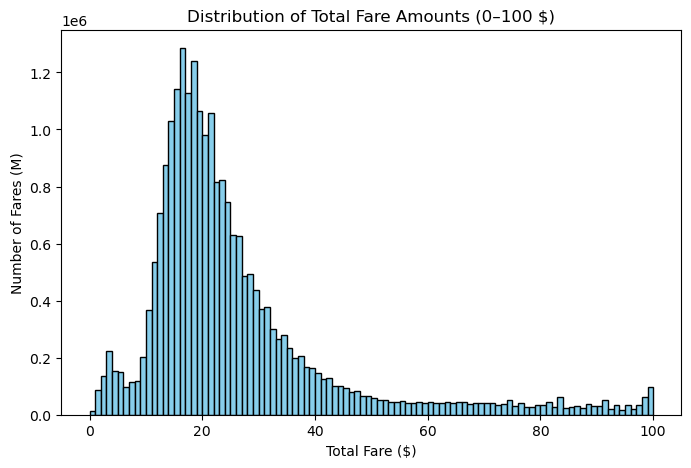

In [19]:
plt.figure(figsize=(8, 5))
df["total_amount"].plot(
    kind="hist",
    bins=100,
    range=(0, 100),
    color="skyblue",
    edgecolor="black",
)

plt.xlabel("Total Fare ($)")
plt.ylabel("Number of Fares (M)")
plt.title("Distribution of Total Fare Amounts (0–100 $)")
plt.show()

## Ride Counts

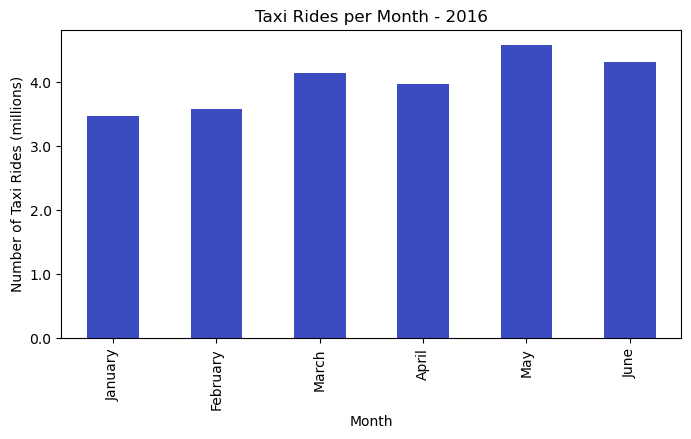

In [20]:
rides_per_month = df.groupby(df["tpep_pickup_datetime"].dt.to_period("M")).size()

ax = rides_per_month.plot(kind="bar", figsize=(8, 4), colormap="coolwarm")

ax.set_xticks(range(len(rides_per_month)))
ax.set_xticklabels(["January", "February", "March", "April", "May", "June"])

ax.yaxis.set_major_formatter(FuncFormatter(lambda x, _: f"{x/1e6:.1f}"))

ax.set_xlabel("Month")
ax.set_ylabel("Number of Taxi Rides (millions)")
ax.set_title("Taxi Rides per Month - 2016")

plt.show()

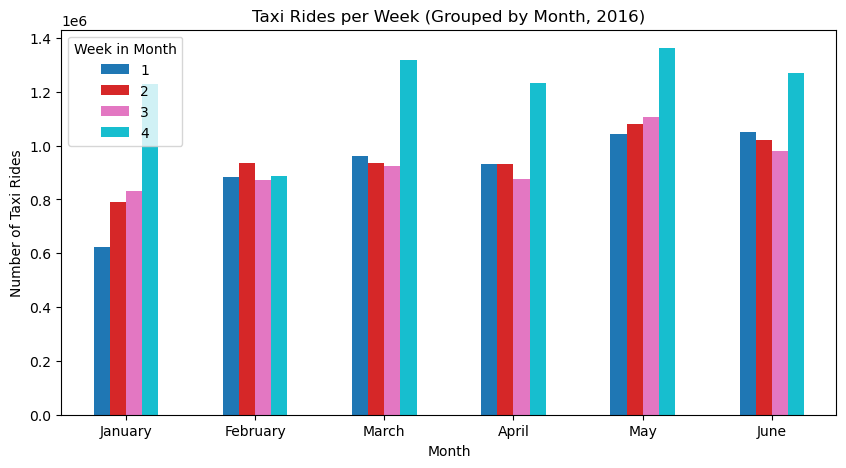

In [21]:
dt = df["tpep_pickup_datetime"]

ride_dates = pd.DataFrame({"year": dt.dt.year, "month": dt.dt.month, "day": dt.dt.day})

ride_dates["week_in_month"] = pd.cut(
    ride_dates["day"], bins=[0, 7, 14, 21, 31], labels=[1, 2, 3, 4], include_lowest=True
).astype(int)

rides = (
    ride_dates.groupby(["year", "month", "week_in_month"])
    .size()
    .reset_index(name="rides")
)

pivot = rides.pivot_table(
    index="month", columns="week_in_month", values="rides", aggfunc="sum", fill_value=0
)

ax = pivot.plot(kind="bar", figsize=(10, 5), colormap="tab10")
ax.set_xlabel("Month")
ax.set_ylabel("Number of Taxi Rides")
ax.set_title("Taxi Rides per Week (Grouped by Month, 2016)")
ax.set_xticklabels(["January", "February", "March", "April", "May", "June"], rotation=0)
plt.legend(title="Week in Month", labels=["1", "2", "3", "4"])
plt.show()

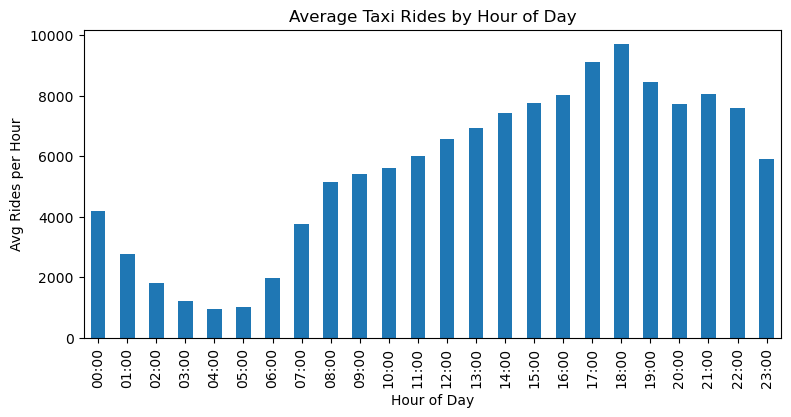

In [22]:
hourly_counts = df.groupby(df["tpep_pickup_datetime"].dt.floor("h")).size()
avg_by_hour = hourly_counts.groupby(hourly_counts.index.hour).mean()

ax = avg_by_hour.plot(kind="bar", figsize=(9, 4))
ax.set_xlabel("Hour of Day")
ax.set_ylabel("Avg Rides per Hour")
ax.set_title("Average Taxi Rides by Hour of Day")

# Format labels as HH:00
ax.set_xticks(range(24))
ax.set_xticklabels([f"{h:02d}:00" for h in range(24)], rotation=90)

plt.show()

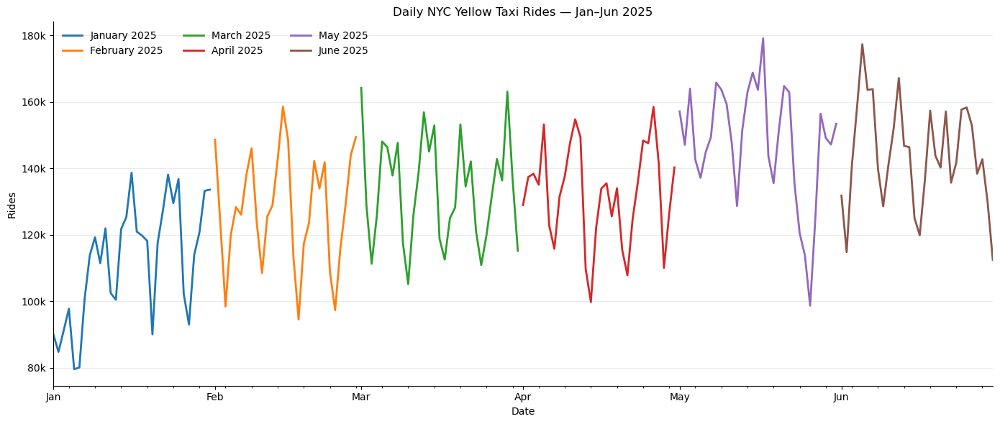

In [23]:
daily = (
    df.set_index("tpep_pickup_datetime")
    .resample("D")
    .size()
    .asfreq("D", fill_value=0)
    .rename("rides")
)

fig, ax = plt.subplots(figsize=(14, 6))

for m in range(1, 7):
    s = daily.loc[f"2025-{m:02d}"]
    ax.plot(s.index, s.values, lw=2, label=pd.Timestamp(2025, m, 1).strftime("%B 2025"))

ax.set_title("Daily NYC Yellow Taxi Rides — Jan–Jun 2025")
ax.set_xlabel("Date")
ax.set_ylabel("Rides")

ax.yaxis.set_major_formatter(FuncFormatter(lambda x, pos: f"{int(x/1000)}k"))

ax.set_xlim(pd.Timestamp("2025-01-01"), pd.Timestamp("2025-06-30"))
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter("%b"))
ax.xaxis.set_minor_locator(mdates.DayLocator(interval=5))  # fewer day ticks for clarity

ax.grid(True, axis="y", alpha=0.25)
ax.legend(ncol=3, frameon=False, loc="upper left")
for spine in ("top", "right"):
    ax.spines[spine].set_visible(False)

plt.tight_layout()
plt.show()

## Trip Distance

In [24]:
desc = (
    df["trip_distance"]
    .describe(percentiles=[0.25, 0.50, 0.75, 0.99])
    .apply(lambda x: f"{x:,.2f}")
)
print(desc)

count    24,083,360.00
mean              6.83
std             630.57
min               0.00
25%               1.02
50%               1.80
75%               3.49
99%              19.42
max         386,088.43
Name: trip_distance, dtype: object


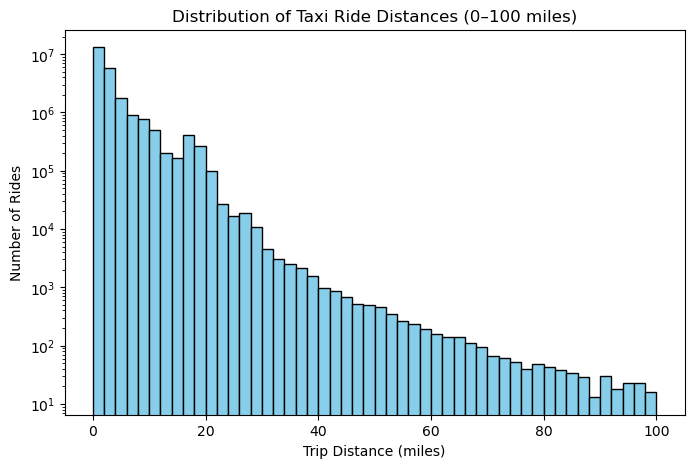

In [25]:
# Plot histogram
plt.figure(figsize=(8, 5))
df["trip_distance"].plot(
    kind="hist", bins=50, range=(0, 100), color="skyblue", edgecolor="black", log=True
)

plt.xlabel("Trip Distance (miles)")
plt.ylabel("Number of Rides")
plt.title("Distribution of Taxi Ride Distances (0–100 miles)")
plt.show()

<Figure size 800x500 with 0 Axes>

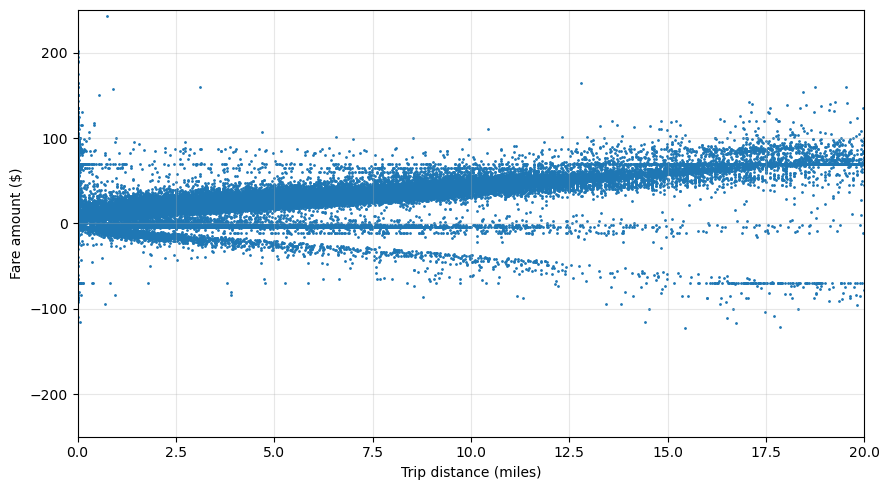

In [26]:
plt.figure(figsize=(8, 5))
data = df.sample(n=200_000, random_state=42)

plt.figure(figsize=(9, 5))
plt.scatter(data["trip_distance"], data["fare_amount"], s=1)
plt.xlim(0, 20)
plt.ylim(-250, 250)
plt.xlabel("Trip distance (miles)")
plt.ylabel("Fare amount ($)")
plt.grid(True, which="both", alpha=0.3)
plt.tight_layout()
plt.show()

## Trip Duration

In [27]:
df["trip_duration"] = df["tpep_dropoff_datetime"] - df["tpep_pickup_datetime"]
df["trip_duration"] = df["trip_duration"].dt.total_seconds() / 60

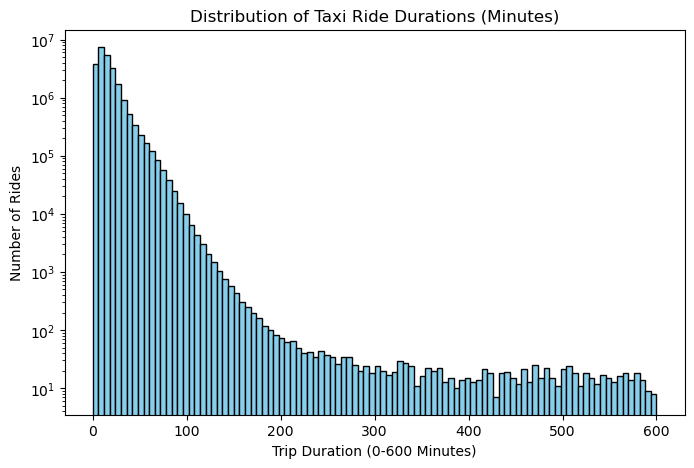

In [28]:
plt.figure(figsize=(8, 5))
df["trip_duration"].plot(
    kind="hist", bins=100, range=(0, 600), color="skyblue", edgecolor="black", log=True
)

plt.xlabel("Trip Duration (0-600 Minutes)")
plt.ylabel("Number of Rides")
plt.title("Distribution of Taxi Ride Durations (Minutes)")
plt.show()

## Passenger Count

In [29]:
df["passenger_count"] = df["passenger_count"].astype("Int64")

In [30]:
df["passenger_count"].value_counts()

passenger_count
1    14801253
2     2583176
3      590567
4      385702
0      138981
5      104553
6       60443
8          52
9          16
7          16
Name: count, dtype: Int64

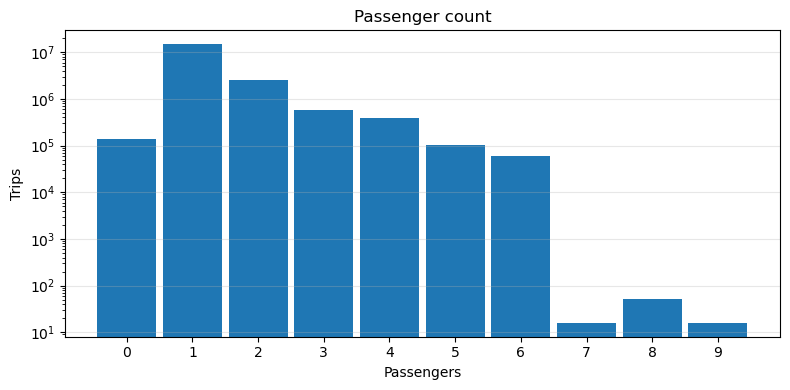

In [31]:
lo = int(df["passenger_count"].min())
hi = int(df["passenger_count"].max())
bins = np.arange(lo - 0.5, hi + 1.5, 1)

plt.figure(figsize=(8, 4))
plt.hist(df["passenger_count"], bins=bins, rwidth=0.9, log=True)
plt.xticks(range(lo, hi + 1))
plt.title("Passenger count")
plt.xlabel("Passengers")
plt.ylabel("Trips")
plt.grid(True, axis="y", alpha=0.3)
plt.tight_layout()
plt.show()

## Ride & Payment Types

In [32]:
df.RatecodeID.value_counts()

RatecodeID
1.0     17440651
2.0       650667
99.0      263813
5.0       193836
3.0        64341
4.0        51425
6.0           26
Name: count, dtype: int64

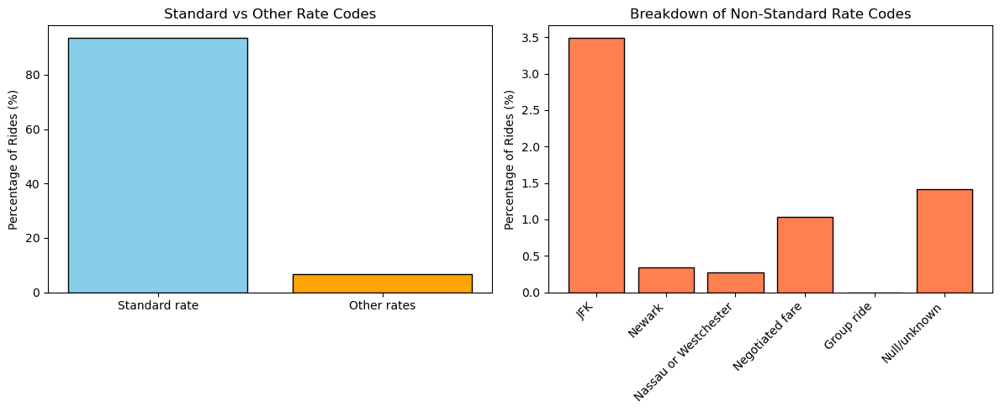

In [33]:
rate_code_dict = {
    1: "Standard rate",
    2: "JFK",
    3: "Newark",
    4: "Nassau or Westchester",
    5: "Negotiated fare",
    6: "Group ride",
    99: "Null/unknown",
}

counts = df.groupby("RatecodeID").size()
total = counts.sum()

counts_other = counts.drop(1).sum()
labels1 = ["Standard rate", "Other rates"]
sizes1 = [counts[1] / total * 100, counts_other / total * 100]

counts_nonstd = counts.drop(1)
labels2 = [rate_code_dict.get(i, str(i)) for i in counts_nonstd.index]
sizes2 = counts_nonstd / total * 100

fig, axes = plt.subplots(1, 2, figsize=(12, 5))

axes[0].bar(labels1, sizes1, color=["skyblue", "orange"], edgecolor="black")
axes[0].set_ylabel("Percentage of Rides (%)")
axes[0].set_title("Standard vs Other Rate Codes")

axes[1].bar(labels2, sizes2, color="coral", edgecolor="black")
axes[1].set_ylabel("Percentage of Rides (%)")
axes[1].set_title("Breakdown of Non-Standard Rate Codes")
axes[1].set_xticklabels(labels2, rotation=45, ha="right")


plt.tight_layout()
plt.show()

In [34]:
df.payment_type.value_counts()

payment_type
1    15609069
0     5418601
2     2353584
4      544216
3      157887
5           3
Name: count, dtype: int64

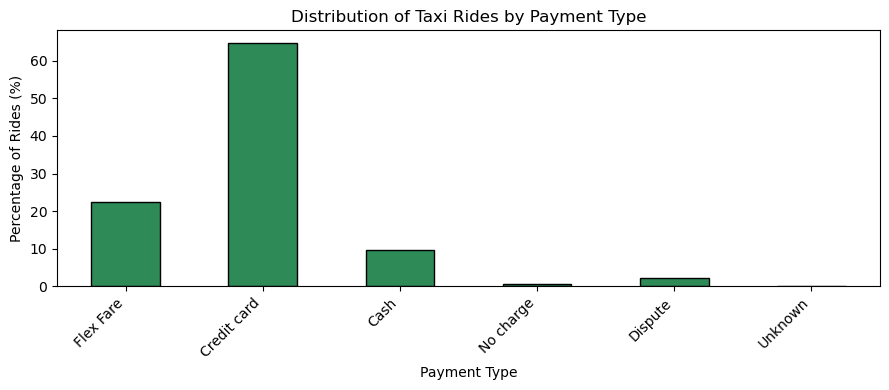

In [35]:
payment_dict = {
    0: "Flex Fare",
    1: "Credit card",
    2: "Cash",
    3: "No charge",
    4: "Dispute",
    5: "Unknown",
    6: "Voided trip",
}


counts = df.groupby("payment_type").size()
percents = counts / counts.sum() * 100

ax = percents.plot(kind="bar", figsize=(9, 4), color="seagreen", edgecolor="black")
ax.set_xticks(range(len(percents)))
ax.set_xticklabels(
    [payment_dict.get(i, str(i)) for i in percents.index], rotation=45, ha="right"
)
ax.set_ylabel("Percentage of Rides (%)")
ax.set_xlabel("Payment Type")
ax.set_title("Distribution of Taxi Rides by Payment Type")

plt.tight_layout()
plt.show()

## Geographical

In [36]:
df.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,trip_duration
0,1,2025-01-01 00:18:38,2025-01-01 00:26:59,1,1.60,1.0,N,229,237,1,10.0,3.5,0.5,3.00,0.0,1.0,18.00,2.5,0.0,0.0,8.350000
1,1,2025-01-01 00:32:40,2025-01-01 00:35:13,1,0.50,1.0,N,236,237,1,5.1,3.5,0.5,2.02,0.0,1.0,12.12,2.5,0.0,0.0,2.550000
2,1,2025-01-01 00:44:04,2025-01-01 00:46:01,1,0.60,1.0,N,141,141,1,5.1,3.5,0.5,2.00,0.0,1.0,12.10,2.5,0.0,0.0,1.950000
3,2,2025-01-01 00:14:27,2025-01-01 00:20:01,3,0.52,1.0,N,244,244,2,7.2,1.0,0.5,0.00,0.0,1.0,9.70,0.0,0.0,0.0,5.566667
4,2,2025-01-01 00:21:34,2025-01-01 00:25:06,3,0.66,1.0,N,244,116,2,5.8,1.0,0.5,0.00,0.0,1.0,8.30,0.0,0.0,0.0,3.533333


In [37]:
zones = gpd.read_file("../data/raw/shape_data/taxi_zones.shp")

In [38]:
zones.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((933100.918 192536.086, 933091.011 19..."
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((1033269.244 172126.008, 103343..."
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((1026308.77 256767.698, 1026495.593 2..."
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,"POLYGON ((992073.467 203714.076, 992068.667 20..."
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,"POLYGON ((935843.31 144283.336, 936046.565 144..."


In [39]:
zones.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 263 entries, 0 to 262
Data columns (total 7 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   OBJECTID    263 non-null    int32   
 1   Shape_Leng  263 non-null    float64 
 2   Shape_Area  263 non-null    float64 
 3   zone        263 non-null    object  
 4   LocationID  263 non-null    int32   
 5   borough     263 non-null    object  
 6   geometry    263 non-null    geometry
dtypes: float64(2), geometry(1), int32(2), object(2)
memory usage: 12.5+ KB


In [40]:
zones.isnull().sum()

OBJECTID      0
Shape_Leng    0
Shape_Area    0
zone          0
LocationID    0
borough       0
geometry      0
dtype: int64

In [41]:
zones.duplicated().sum()

np.int64(0)

In [42]:
zones.crs

<Projected CRS: EPSG:2263>
Name: NAD83 / New York Long Island (ftUS)
Axis Info [cartesian]:
- X[east]: Easting (US survey foot)
- Y[north]: Northing (US survey foot)
Area of Use:
- name: United States (USA) - New York - counties of Bronx; Kings; Nassau; New York; Queens; Richmond; Suffolk.
- bounds: (-74.26, 40.47, -71.8, 41.3)
Coordinate Operation:
- name: SPCS83 New York Long Island zone (US survey foot)
- method: Lambert Conic Conformal (2SP)
Datum: North American Datum 1983
- Ellipsoid: GRS 1980
- Prime Meridian: Greenwich

In [43]:
cent_proj = zones.to_crs(2263).geometry.centroid
cent_wgs = gpd.GeoSeries(cent_proj, crs=2263).to_crs(4326)

zones["lon"] = cent_wgs.x
zones["lat"] = cent_wgs.y

zones = zones.to_crs(4326)

In [44]:
zones.head()

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry,lon,lat
0,1,0.116357,0.000782,Newark Airport,1,EWR,"POLYGON ((-74.18445 40.695, -74.18449 40.6951,...",-74.174002,40.691830
1,2,0.433470,0.004866,Jamaica Bay,2,Queens,"MULTIPOLYGON (((-73.82338 40.63899, -73.82277 ...",-73.831300,40.616746
2,3,0.084341,0.000314,Allerton/Pelham Gardens,3,Bronx,"POLYGON ((-73.84793 40.87134, -73.84725 40.870...",-73.847422,40.864474
3,4,0.043567,0.000112,Alphabet City,4,Manhattan,"POLYGON ((-73.97177 40.72582, -73.97179 40.725...",-73.976968,40.723752
4,5,0.092146,0.000498,Arden Heights,5,Staten Island,"POLYGON ((-74.17422 40.56257, -74.17349 40.562...",-74.188485,40.552659


In [45]:
for column in ["zone", "LocationID", "borough"]:
    print(zones[column].value_counts(), "\n")

zone
Governor's Island/Ellis Island/Liberty Island    3
Corona                                           2
Two Bridges/Seward Park                          1
Belmont                                          1
West Farms/Bronx River                           1
                                                ..
Bayside                                          1
Bedford                                          1
Bedford Park                                     1
Bellerose                                        1
Alphabet City                                    1
Name: count, Length: 260, dtype: int64 

LocationID
103    3
56     2
232    1
20     1
248    1
      ..
16     1
17     1
18     1
19     1
4      1
Name: count, Length: 260, dtype: int64 

borough
Queens           69
Manhattan        69
Brooklyn         61
Bronx            43
Staten Island    20
EWR               1
Name: count, dtype: int64 



In [46]:
zones[zones.duplicated(subset=["zone"], keep=False)]
zones[zones.duplicated(subset=["LocationID"], keep=False)]

,OBJECTID,Shape_Leng,Shape_Area,zone,LocationID,borough,geometry,lon,lat
55,56,0.056848,0.000181,Corona,56,Queens,"POLYGON ((-73.85361 40.7475, -73.85325 40.7468...",-73.858845,40.741407
56,57,0.019271,0.000018,Corona,56,Queens,"POLYGON ((-73.85131 40.74984, -73.85443 40.748...",-73.853582,40.751819
102,103,0.014306,0.000006,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((-74.04389 40.69018, -74.04351 40.689...",-74.045288,40.689860
103,104,0.021221,0.000012,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((-74.03995 40.70089, -74.03945 40.700...",-74.040771,40.698769
104,105,0.077425,0.000369,Governor's Island/Ellis Island/Liberty Island,103,Manhattan,"POLYGON ((-74.01675 40.69334, -74.0154 40.6930...",-74.019073,40.688784


In [47]:
zones["geometry"] = zones.geometry.buffer(0)


def mode_or_first(s: pd.Series):
    m = s.mode(dropna=True)
    return (
        m.iloc[0] if not m.empty else (s.dropna().iloc[0] if s.notna().any() else None)
    )


agg = {"zone": mode_or_first, "borough": mode_or_first}
zones = zones.dissolve(by="LocationID", aggfunc=agg).reset_index()

if zones.crs is None or zones.crs.to_epsg() != 2263:
    zones = zones.to_crs(2263)

centers_2263 = zones.geometry.centroid
centers_wgs84 = centers_2263.to_crs(4326)

zones["lon"] = centers_wgs84.x
zones["lat"] = centers_wgs84.y

In [48]:
zones.head()

,LocationID,geometry,zone,borough,lon,lat
0,1,"POLYGON ((933100.918 192536.086, 933091.011 19...",Newark Airport,EWR,-74.174002,40.691830
1,2,"MULTIPOLYGON (((1020447.262 151454.148, 102035...",Jamaica Bay,Queens,-73.831300,40.616746
2,3,"POLYGON ((1026308.77 256767.698, 1026495.593 2...",Allerton/Pelham Gardens,Bronx,-73.847422,40.864474
3,4,"POLYGON ((992073.467 203714.076, 992068.667 20...",Alphabet City,Manhattan,-73.976968,40.723752
4,5,"POLYGON ((935843.31 144283.336, 936046.565 144...",Arden Heights,Staten Island,-74.188485,40.552659


In [49]:
df.head()

,VendorID,tpep_pickup_datetime,tpep_dropoff_datetime,passenger_count,trip_distance,RatecodeID,store_and_fwd_flag,PULocationID,DOLocationID,payment_type,fare_amount,extra,mta_tax,tip_amount,tolls_amount,improvement_surcharge,total_amount,congestion_surcharge,Airport_fee,cbd_congestion_fee,trip_duration
0,1,2025-01-01 00:18:38,2025-01-01 00:26:59,1,1.60,1.0,N,229,237,1,10.0,3.5,0.5,3.00,0.0,1.0,18.00,2.5,0.0,0.0,8.350000
1,1,2025-01-01 00:32:40,2025-01-01 00:35:13,1,0.50,1.0,N,236,237,1,5.1,3.5,0.5,2.02,0.0,1.0,12.12,2.5,0.0,0.0,2.550000
2,1,2025-01-01 00:44:04,2025-01-01 00:46:01,1,0.60,1.0,N,141,141,1,5.1,3.5,0.5,2.00,0.0,1.0,12.10,2.5,0.0,0.0,1.950000
3,2,2025-01-01 00:14:27,2025-01-01 00:20:01,3,0.52,1.0,N,244,244,2,7.2,1.0,0.5,0.00,0.0,1.0,9.70,0.0,0.0,0.0,5.566667
4,2,2025-01-01 00:21:34,2025-01-01 00:25:06,3,0.66,1.0,N,244,116,2,5.8,1.0,0.5,0.00,0.0,1.0,8.30,0.0,0.0,0.0,3.533333


In [50]:
# 1) Convert zones to GeoDataFrame
SET_CRS = "EPSG:2263"

if isinstance(zones, gpd.GeoDataFrame):
    zones_gdf = zones.copy()
    if zones_gdf.crs is None:
        zones_gdf = zones_gdf.set_crs(SET_CRS)
else:
    geom_col = zones["geometry"]
    geom = geom_col.map(wkt.loads) if isinstance(geom_col.iloc[0], str) else geom_col
    zones_gdf = gpd.GeoDataFrame(
        zones.drop(columns=["geometry"]).copy(),
        geometry=gpd.GeoSeries(geom),
        crs=SET_CRS,
    )

zones_gdf = zones_gdf.to_crs(epsg=4326)

# 2) Aggregate rides + avg fare
agg = (
    df.groupby("PULocationID", as_index=False)
    .agg(rides=("PULocationID", "size"), avg_total_fare=("total_amount", "mean"))
    .rename(columns={"PULocationID": "LocationID"})
)

g = zones_gdf.merge(agg, on="LocationID", how="left")
g["rides"] = g["rides"].fillna(0).astype(int)
g["avg_total_fare"] = g["avg_total_fare"].fillna(0).apply(lambda x: float(f"{x:.2g}"))

# 3) Folium map
center = [g.geometry.unary_union.centroid.y, g.geometry.unary_union.centroid.x]
m = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")
gj = g.to_json()

# Choropleth: Total rides (Blues)
folium.Choropleth(
    geo_data=gj,
    data=g[["LocationID", "rides"]],
    columns=["LocationID", "rides"],
    key_on="feature.properties.LocationID",
    fill_color="Blues",
    fill_opacity=0.7,
    line_opacity=0.3,
    nan_fill_opacity=0.0,
    name="Total rides",
    legend_name="Total rides per zone",
).add_to(m)

# Choropleth: Avg fare (Oranges)
folium.Choropleth(
    geo_data=gj,
    data=g[["LocationID", "avg_total_fare"]],
    columns=["LocationID", "avg_total_fare"],
    key_on="feature.properties.LocationID",
    fill_color="Oranges",
    fill_opacity=0.7,
    line_opacity=0.3,
    nan_fill_opacity=0.0,
    name="Avg total fare",
    legend_name="Average total fare ($)",
).add_to(m)

GeoJson(
    gj,
    control=False,
    style_function=lambda x: {
        "weight": 0.5,
        "color": "#666",
        "fillOpacity": 0,
    },
    highlight_function=lambda x: {
        "weight": 3,
        "color": "#000",
        "fillOpacity": 0,
    },
    tooltip=GeoJsonTooltip(
        fields=["LocationID", "zone", "borough", "rides", "avg_total_fare"],
        aliases=["LocationID", "Zone", "Borough", "Total rides", "Avg total fare ($)"],
        localize=True,
        sticky=True,
        permanent=False,
    ),
).add_to(m)

folium.LayerControl(collapsed=False).add_to(m)
m

In [51]:
# Top 3 pairs by rides
top3 = (
    df.groupby(["PULocationID", "DOLocationID"], as_index=False)
    .size()
    .rename(columns={"size": "rides"})
    .sort_values("rides", ascending=False)
    .head(3)
    .reset_index(drop=True)
)

# Centroids
cent = zones_gdf.copy()
cent["centroid"] = cent.geometry.centroid
cent["clon"] = cent.centroid.x
cent["clat"] = cent.centroid.y
clook = cent.set_index("LocationID")[["zone", "borough", "clon", "clat"]]

# Base map
center = [
    zones_gdf.geometry.unary_union.centroid.y,
    zones_gdf.geometry.unary_union.centroid.x,
]
m = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")

# Light base polygons
folium.GeoJson(
    zones_gdf.to_json(),
    style_function=lambda f: {
        "color": "#bdbdbd",
        "weight": 0.6,
        "fillColor": "#ffffff",
        "fillOpacity": 0.03,
    },
    control=False,
).add_to(m)

groups = {"Top pairs (by rides)": []}


def make_rank_layer(idx, row, start_fill="#2ecc71", end_fill="#e74c3c"):
    pu, do, rides = int(row.PULocationID), int(row.DOLocationID), int(row.rides)
    if pu not in clook.index or do not in clook.index:
        return None
    a, b = clook.loc[pu], clook.loc[do]

    layer = folium.FeatureGroup(
        name=f"Rank {idx+1}: {rides:,} rides",
        show=(idx == 0),
    )

    # START zone polygon
    folium.GeoJson(
        zones_gdf[zones_gdf.LocationID == pu].to_json(),
        style_function=lambda f: {
            "color": start_fill,
            "weight": 3,
            "fillOpacity": 0.35,
            "fillColor": start_fill,
        },
        tooltip=GeoJsonTooltip(
            fields=["zone", "borough", "LocationID"],
            aliases=["Zone", "Borough", "LocationID"],
            sticky=True,
        ),
    ).add_to(layer)

    # END zone polygon
    folium.GeoJson(
        zones_gdf[zones_gdf.LocationID == do].to_json(),
        style_function=lambda f: {
            "color": end_fill,
            "weight": 3,
            "fillOpacity": 0.35,
            "fillColor": end_fill,
        },
        tooltip=GeoJsonTooltip(
            fields=["zone", "borough", "LocationID"],
            aliases=["Zone", "Borough", "LocationID"],
            sticky=True,
        ),
    ).add_to(layer)

    folium.Marker(
        (a.clat, a.clon),
        tooltip=f"START • {a.zone} ({a.borough})",
        icon=DivIcon(
            html="""
          <div style="width:22px;height:22px;line-height:22px;border-radius:50%;
                      background:#2ecc71;color:#fff;text-align:center;
                      font-size:13px;font-weight:700;border:1px solid #2b8a3e;">
            S
          </div>""",
            icon_size=(22, 22),
            icon_anchor=(11, 11),
        ),
    ).add_to(layer)

    folium.Marker(
        (b.clat, b.clon),
        tooltip=f"END • {b.zone} ({b.borough})",
        icon=DivIcon(
            html="""
          <div style="width:22px;height:22px;line-height:22px;border-radius:50%;
                      background:#e74c3c;color:#fff;text-align:center;
                      font-size:13px;font-weight:700;border:1px solid #c92a2a;">
            E
          </div>""",
            icon_size=(22, 22),
            icon_anchor=(11, 11),
        ),
    ).add_to(layer)

    layer.add_to(m)
    return layer


rank_layers = []
for i, r in top3.iterrows():
    lyr = make_rank_layer(i, r)
    if lyr is not None:
        rank_layers.append(lyr)

groups["Top pairs (by rides)"] = rank_layers
plugins.GroupedLayerControl(
    groups=groups, exclusive_groups=True, collapsed=False, position="topright"
).add_to(m)

# Legend
legend_html = """
<div style="
 position: fixed; bottom: 18px; left: 18px; z-index: 9999;
 background: white; padding: 8px 10px; border: 1px solid #bbb; border-radius: 6px;
 font-size: 12px; box-shadow: 0 1px 4px rgba(0,0,0,0.2);
">
  <div style="font-weight:700; margin-bottom:4px;">Legend</div>
  <div><span style="display:inline-block;width:12px;height:12px;background:#2ecc71;
       border-radius:50%;border:1px solid #2b8a3e;margin-right:5px;"></span>START zone</div>
  <div><span style="display:inline-block;width:12px;height:12px;background:#e74c3c;
       border-radius:50%;border:1px solid #c92a2a;margin-right:5px;"></span>END zone</div>
</div>
"""
m.get_root().html.add_child(folium.Element(legend_html))

m

In [52]:
# 1) Remove outliers on total_amount and trip_distance (0.01–0.99)
t = (
    df[["PULocationID", "DOLocationID", "total_amount", "trip_distance"]]
    .dropna()
    .copy()
)

# Positive distance guard
t = t[t["trip_distance"] > 0]

q = t[["total_amount", "trip_distance"]].quantile([0.01, 0.99])
ta_lo, ta_hi = q.loc[0.01, "total_amount"], q.loc[0.99, "total_amount"]
td_lo, td_hi = q.loc[0.01, "trip_distance"], q.loc[0.99, "trip_distance"]

t = t[
    (t["total_amount"].between(ta_lo, ta_hi))
    & (t["trip_distance"].between(td_lo, td_hi))
]

# 2) Aggregate per (PU, DO): avg $/dist = sum($) / sum(dist)
agg = t.groupby(["PULocationID", "DOLocationID"], as_index=False).agg(
    total_amt=("total_amount", "sum"), total_dist=("trip_distance", "sum")
)
agg = agg[agg["total_dist"] > 0]
agg["avg_amt_per_dist"] = agg["total_amt"] / agg["total_dist"]

top3 = (
    agg.sort_values("avg_amt_per_dist", ascending=False).head(3).reset_index(drop=True)
)

# 3) Centroids for S/E badges
cent = zones_gdf.copy()
cent["centroid"] = cent.geometry.centroid
cent["clon"] = cent.centroid.x
cent["clat"] = cent.centroid.y
clook = cent.set_index("LocationID")[["zone", "borough", "clon", "clat"]]

# 4) Base map
center = [
    zones_gdf.geometry.unary_union.centroid.y,
    zones_gdf.geometry.unary_union.centroid.x,
]
m = folium.Map(location=center, zoom_start=11, tiles="cartodbpositron")

# Light base polygons
folium.GeoJson(
    zones_gdf.to_json(),
    style_function=lambda f: {
        "color": "#bdbdbd",
        "weight": 0.6,
        "fillColor": "#ffffff",
        "fillOpacity": 0.03,
    },
    control=False,
).add_to(m)

# 5) Rank layers
groups = {"Top pairs (avg $/distance)": []}


def make_rank_layer(idx, row, start_fill="#2ecc71", end_fill="#e74c3c"):
    pu, do = int(row.PULocationID), int(row.DOLocationID)
    if pu not in clook.index or do not in clook.index:
        return None
    a, b = clook.loc[pu], clook.loc[do]
    metric = float(f"{row.avg_amt_per_dist:.2g}")  # 2 significant figures

    layer = folium.FeatureGroup(name=f"Rank {idx+1}: {metric} $/dist", show=(idx == 0))

    # START zone polygon
    folium.GeoJson(
        zones_gdf[zones_gdf.LocationID == pu].to_json(),
        style_function=lambda f: {
            "color": start_fill,
            "weight": 3,
            "fillOpacity": 0.35,
            "fillColor": start_fill,
        },
        tooltip=GeoJsonTooltip(
            fields=["zone", "borough", "LocationID"],
            aliases=["Zone", "Borough", "LocationID"],
            sticky=True,
        ),
    ).add_to(layer)

    # END zone polygon
    folium.GeoJson(
        zones_gdf[zones_gdf.LocationID == do].to_json(),
        style_function=lambda f: {
            "color": end_fill,
            "weight": 3,
            "fillOpacity": 0.35,
            "fillColor": end_fill,
        },
        tooltip=GeoJsonTooltip(
            fields=["zone", "borough", "LocationID"],
            aliases=["Zone", "Borough", "LocationID"],
            sticky=True,
        ),
    ).add_to(layer)

    # S / E badges
    folium.Marker(
        (a.clat, a.clon),
        tooltip=f"START • {a.zone} ({a.borough})",
        icon=DivIcon(
            html="""
          <div style="width:22px;height:22px;line-height:22px;border-radius:50%;
                      background:#2ecc71;color:#fff;text-align:center;
                      font-size:13px;font-weight:700;border:1px solid #2b8a3e;">S</div>""",
            icon_size=(22, 22),
            icon_anchor=(11, 11),
        ),
    ).add_to(layer)
    folium.Marker(
        (b.clat, b.clon),
        tooltip=f"END • {b.zone} ({b.borough})",
        icon=DivIcon(
            html="""
          <div style="width:22px;height:22px;line-height:22px;border-radius:50%;
                      background:#e74c3c;color:#fff;text-align:center;
                      font-size:13px;font-weight:700;border:1px solid #c92a2a;">E</div>""",
            icon_size=(22, 22),
            icon_anchor=(11, 11),
        ),
    ).add_to(layer)

    layer.add_to(m)
    return layer


rank_layers = []
for i, r in top3.iterrows():
    lyr = make_rank_layer(i, r)
    if lyr is not None:
        rank_layers.append(lyr)

plugins.GroupedLayerControl(
    groups={"Top pairs (avg $/distance)": rank_layers},
    exclusive_groups=True,
    collapsed=False,
    position="topright",
).add_to(m)

m